#1. 필요한 라이브러리 설치:
Colab 노트북에서 다음 명령어를 실행하여 필요한 라이브러리를 설치합니다.

In [1]:
!pip install opencv-python-headless
!pip install opencv-contrib-python

# 2. 라이브러리 import:

In [2]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from PIL import Image
import torch
import time
from concurrent.futures import ThreadPoolExecutor
from IPython.display import clear_output # 각 프레임 후에 출력 지우기

# 3. 이미지 업로드:
Colab에서 이미지를 업로드하거나 URL을 통해 이미지를 가져옵니다.


# 4. SIFT 특징 추출 코드

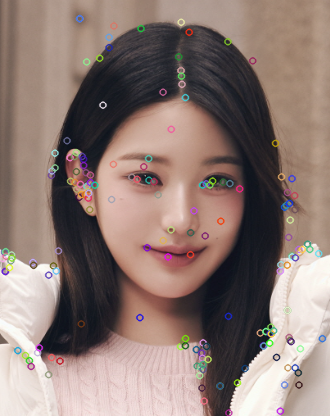

In [3]:
# 이미지 로드
img = cv2.imread('sample.png')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# SIFT 객체 생성
sift = cv2.SIFT_create()

# 키포인트와 디스크립터 추출
keypoints, descriptors = sift.detectAndCompute(gray, None)

# 특징점 그리기
img_with_keypoints = cv2.drawKeypoints(img, keypoints, None)

# 결과 출력
cv2_imshow(img_with_keypoints)

In [4]:
# CUDA를 사용할 수 있는지 확인
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [5]:
# SIFT 객체 생성
sift = cv2.SIFT_create()

In [6]:
# FLANN 매처 설정
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
search_params = dict(checks=50)
flann = cv2.FlannBasedMatcher(index_params, search_params)

In [7]:
# 대조군 이미지 로드 및 특징 추출
reference_img = img
reference_kp, reference_des = sift.detectAndCompute(reference_img, None)


In [8]:
# 특징 매칭 함수
def match_features(des1, des2):
    matches = flann.knnMatch(des1, des2, k=2)
    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)
    return good_matches


In [9]:
# 프레임 처리 함수
def process_frame(frame):
    # 그레이스케일 변환
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # SIFT 특징 추출
    kp, des = sift.detectAndCompute(gray, None)

    # 특징 매칭
    good_matches = match_features(des, reference_des)

    # 결과 시각화
    img_matches = cv2.drawMatches(frame, kp, reference_img, reference_kp, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

    return img_matches, len(good_matches)

In [10]:
# 비디오 캡처 객체 생성

# cap = cv2.VideoCapture('path_to_your_video.mp4')

In [11]:
# 파일 경로 설정
file_path = 'video.webm'  # 업로드한 파일명으로 변경

# 비디오 캡처
cap = cv2.VideoCapture(file_path)

In [12]:
# 동영상의 FPS 얻기
fps = cap.get(cv2.CAP_PROP_FPS)
print(f"Video FPS: {fps}")

# 검색하고자 하는 구간 설정 (초 단위)
start_time = 30  # 시작 시간
end_time = 60    # 종료 시간

# 프레임 번호로 변환
start_frame = int(start_time * fps)
end_frame = int(end_time * fps)

Video FPS: 23.979623824451412


In [13]:
# 시작 프레임으로 이동
cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame)


True

In [14]:
# ThreadPoolExecutor 생성
executor = ThreadPoolExecutor(max_workers=4)

In [15]:
# # 프레임 카운터 및 FPS 계산을 위한 변수
# frame_count = 0
# start_time = time.time()


In [16]:
# 프레임 카운터 및 시간 측정 초기화
frame_count = start_frame
start_process_time = time.time()


In [17]:
# 쿨다운 타이머 :
last_detection_time = 0
COOLDOWN_SECONDS = 2  # 2초 쿨다운

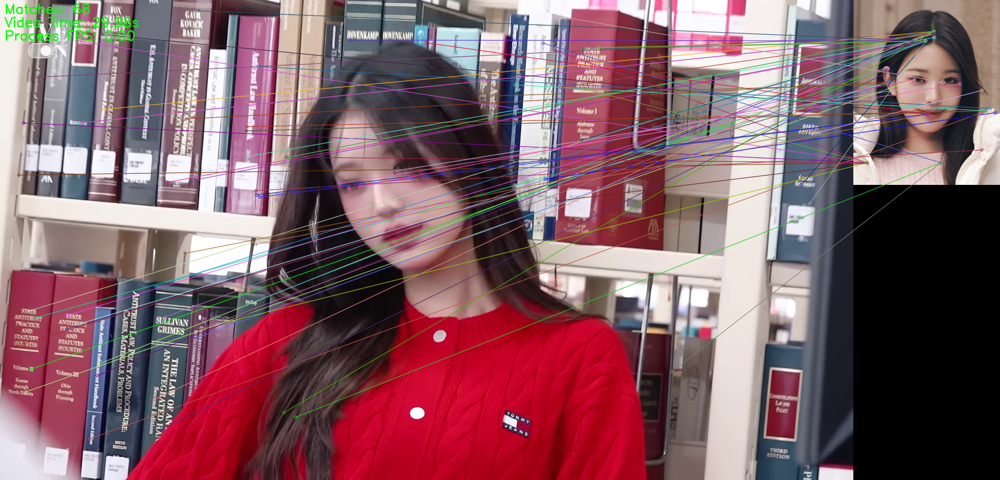

Match found at 29.98s with 68 matches


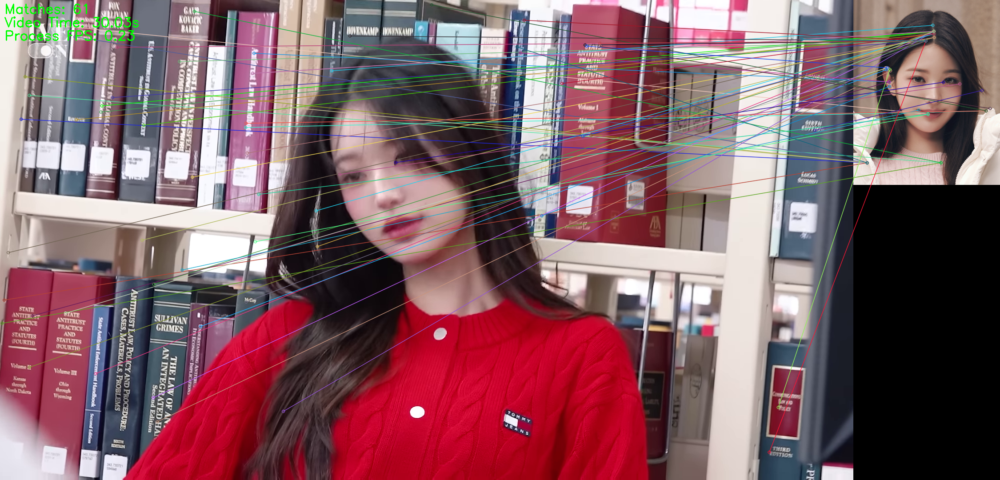

Match found at 30.03s with 61 matches


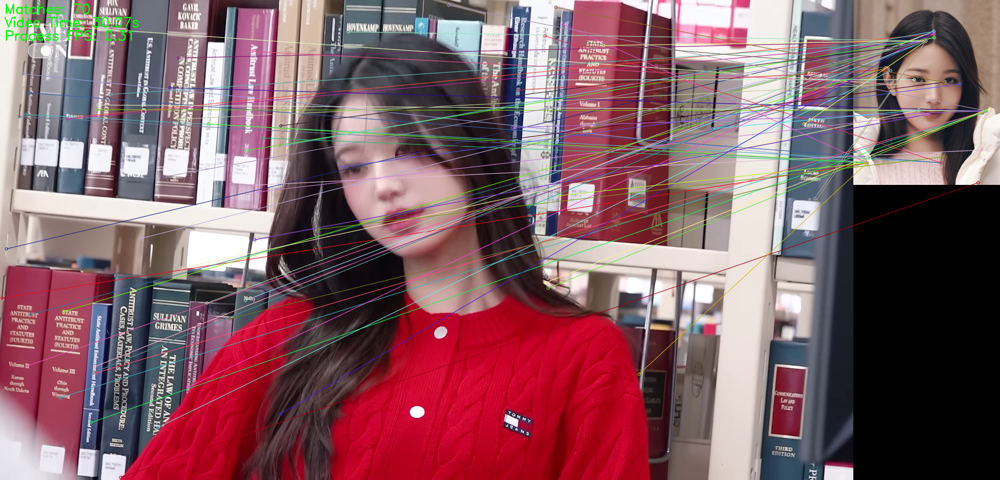

Match found at 30.07s with 70 matches


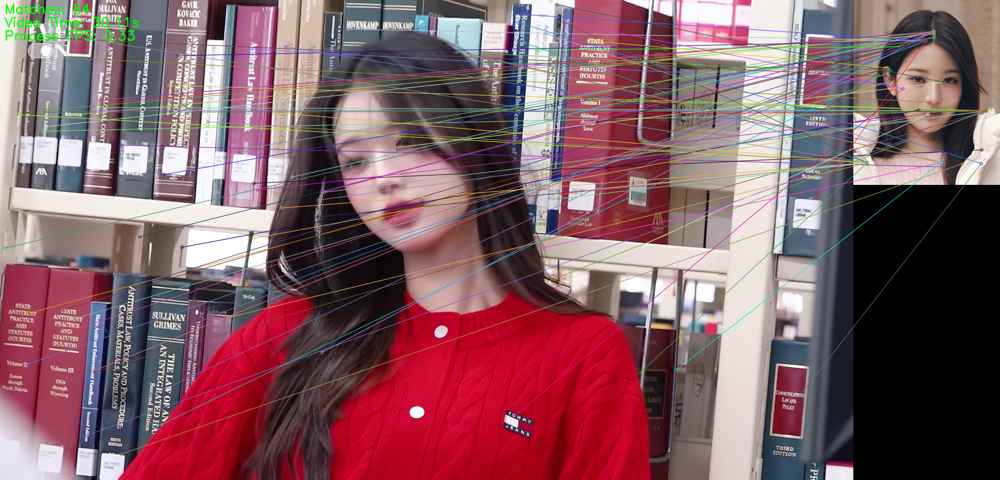

Match found at 30.11s with 84 matches


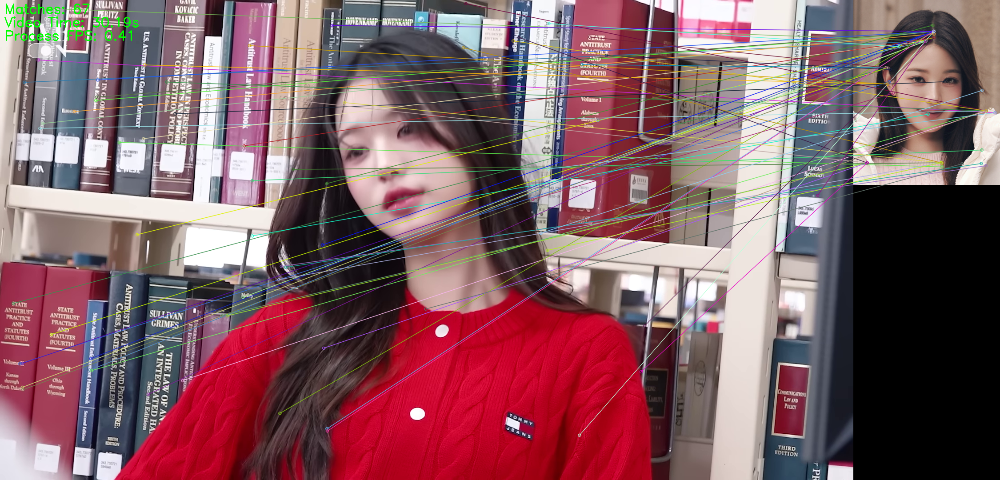

Match found at 30.19s with 67 matches


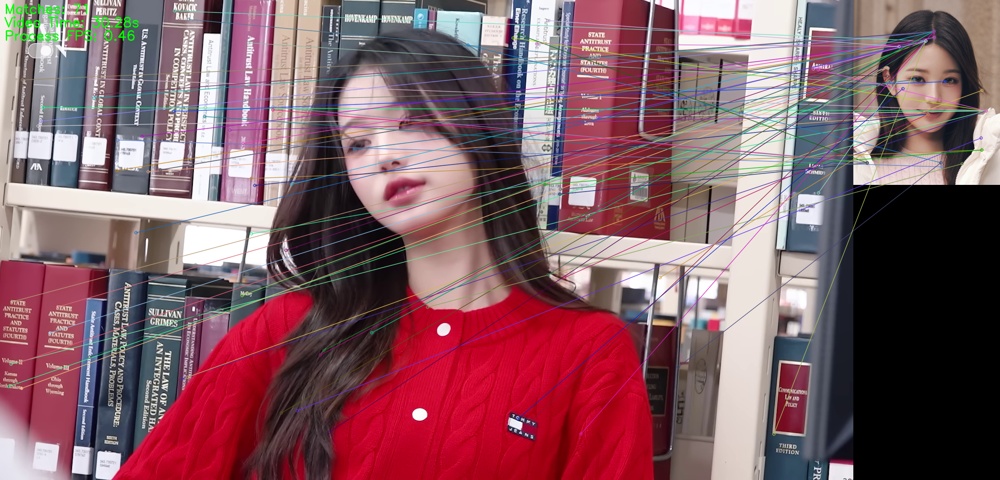

Match found at 30.28s with 71 matches


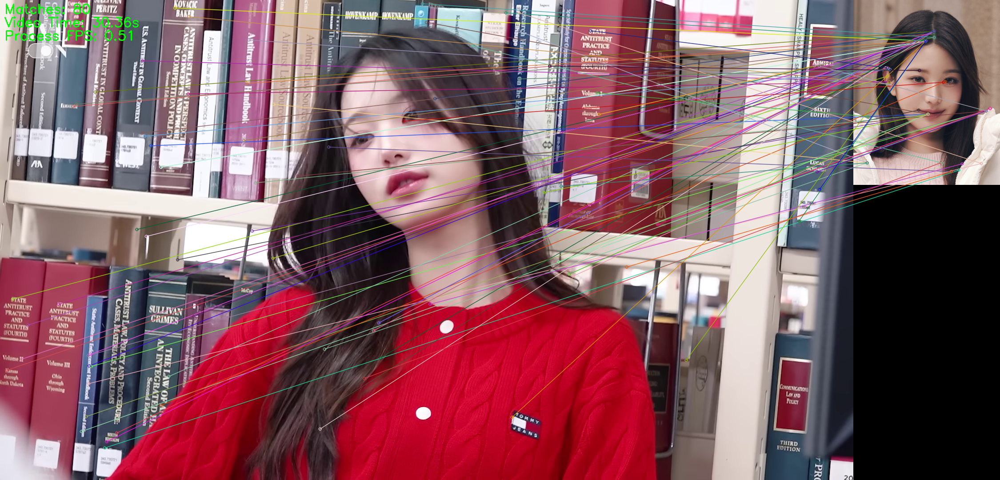

Match found at 30.36s with 80 matches


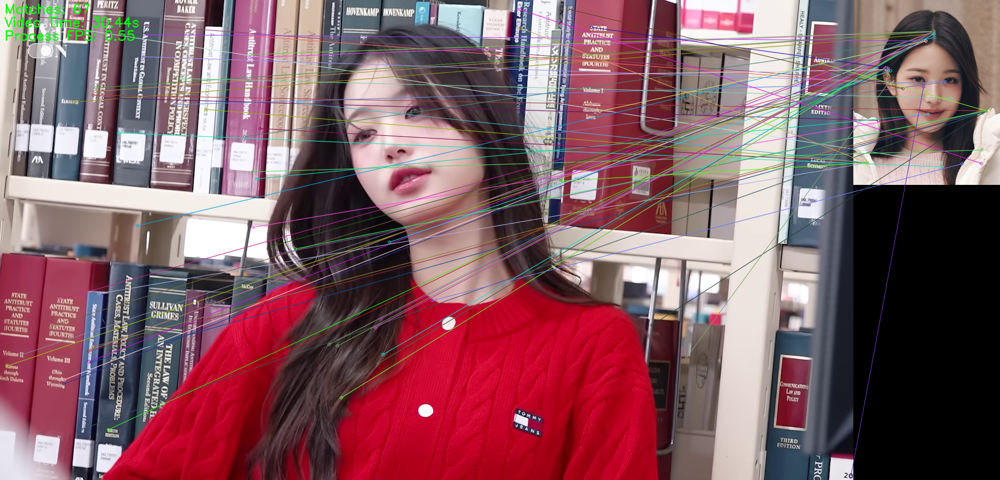

Match found at 30.44s with 67 matches


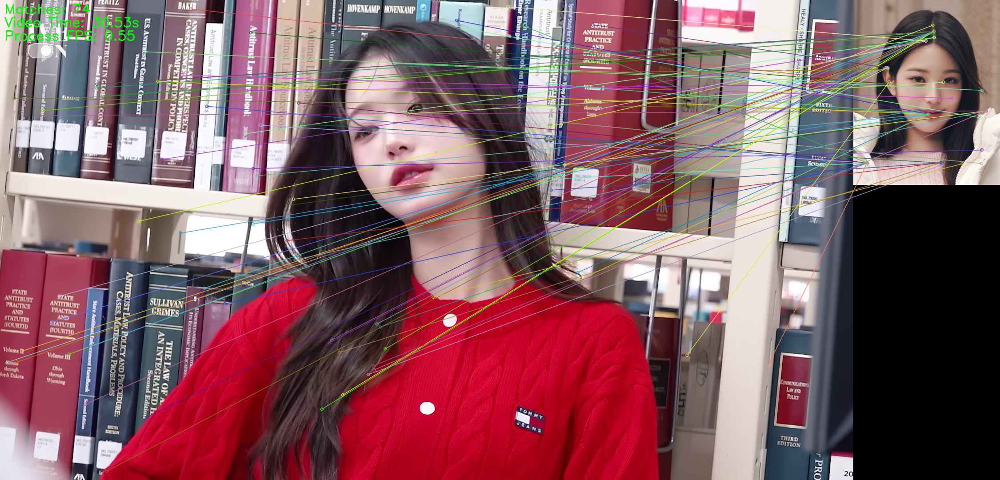

Match found at 30.53s with 74 matches


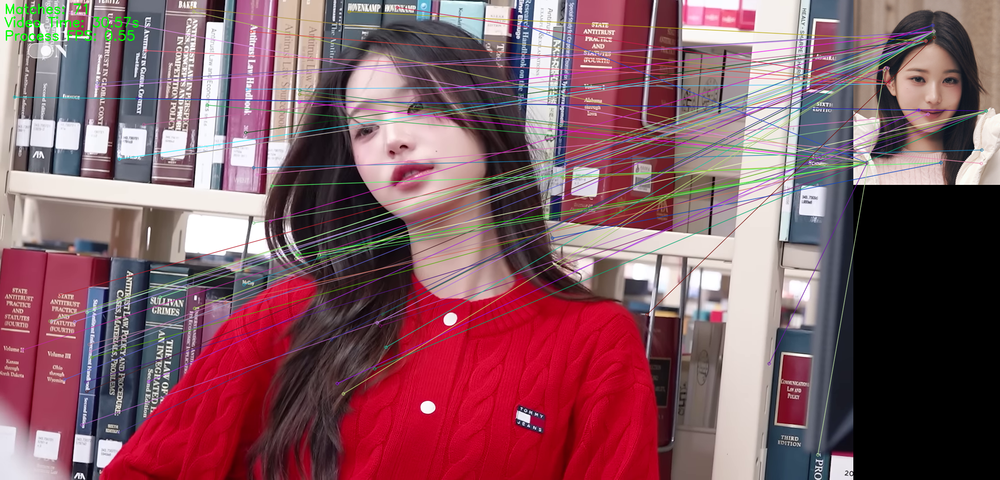

Match found at 30.57s with 71 matches


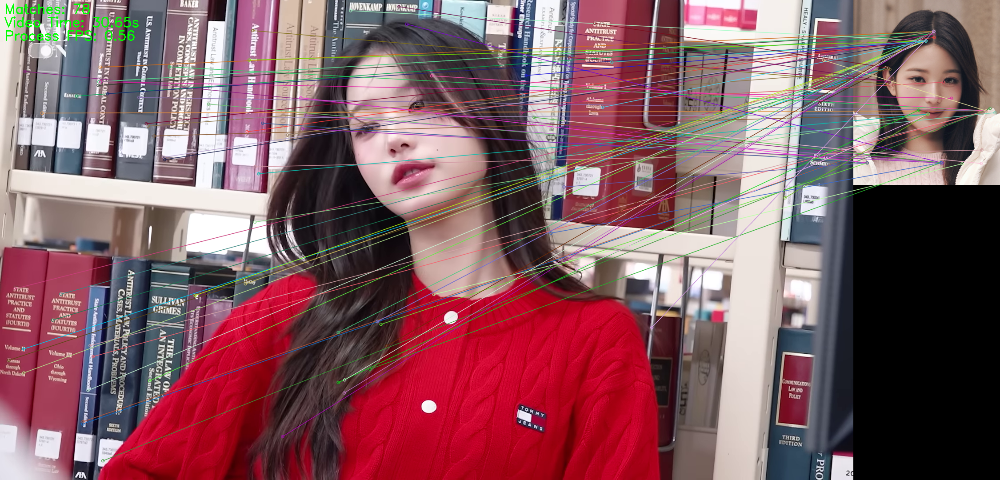

Match found at 30.65s with 78 matches


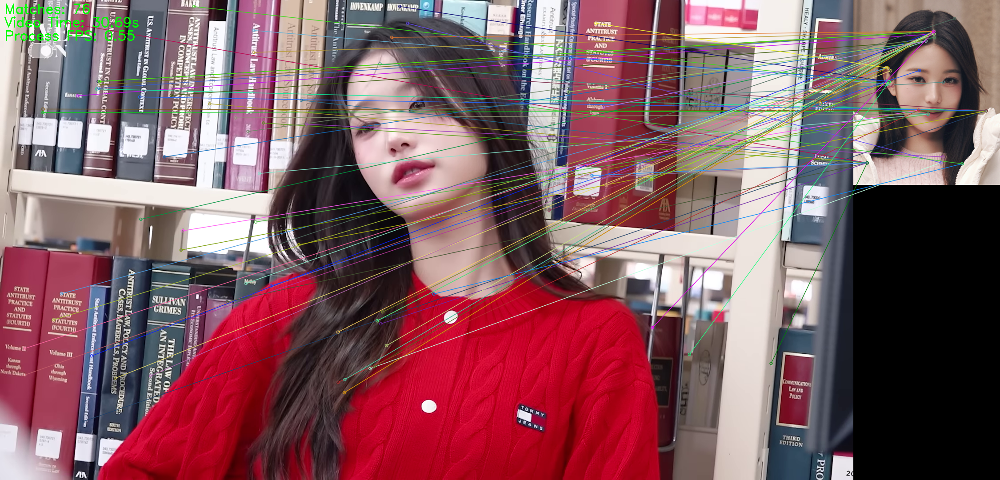

Match found at 30.69s with 76 matches
Buffered data was truncated after reaching the output size limit.

In [ ]:

# while True:
while frame_count < end_frame:
    ret, frame = cap.read()

    if not ret:
        break

    # 현재 프레임 시간 계산
    current_video_time = frame_count / fps

    # 프레임 크기 축소 (성능 향상을 위해)
    # frame = cv2.resize(frame, (640, 480))

    # 프레임 처리를 ThreadPoolExecutor에 제출
    future = executor.submit(process_frame, frame)

    # 결과 얻기
    img_matches, num_matches = future.result()

    # 결과 표시
    # 매치 수가 50 이상일 때만 결과 표시
    # cv2.putText(img_matches, f"Matches: {num_matches}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    # # cv2.imshow('Matches', img_matches)
    # cv2_imshow(img_matches)
    current_time = time.time()
    if num_matches >= 1 and current_time - last_detection_time >= COOLDOWN_SECONDS:
    # if num_matches >= 50:
        # current_time = time.time()
        # if current_time - last_detection_time >= COOLDOWN_SECONDS:

        # 처리 시간 계산
        elapsed_time = time.time() - start_process_time
        process_fps = (frame_count - start_frame) / elapsed_time

        # # 결과 표시 코드
        # last_detection_time = current_time

        # # FPS 계산
        # frame_count += 1
        # elapsed_time = time.time() - start_time
        # fps = frame_count / elapsed_time

        # 결과 이미지에 정보 추가
        # cv2.putText(img_matches, f"Matches: {num_matches}", (10, 30),
        #             cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        # cv2.putText(img_matches, f"FPS: {fps:.2f}", (10, 60),
        #             cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        cv2.putText(img_matches, f"Matches: {num_matches}", (10, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        cv2.putText(img_matches, f"Video Time: {current_video_time:.2f}s", (10, 60),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
        cv2.putText(img_matches, f"Process FPS: {process_fps:.2f}", (10, 90),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

        # 결과 표시
        cv2_imshow(img_matches)

        # 출력 지우기 (선택사항)
        # from IPython.display import clear_output
        # clear_output(wait=True)

        # # 결과를 찾았을 때의 시간 기록 (선택사항)
        # print(f"Match found at frame {frame_count} with {num_matches} matches")
        # print(f"Time elapsed: {elapsed_time:.2f} seconds")

        # 결과 로그 출력
        print(f"Match found at {current_video_time:.2f}s with {num_matches} matches")

        last_detection_time = current_time

    # FPS 계산 및 표시
    frame_count += 1
    # elapsed_time = time.time() - start_time
    # fps = frame_count / elapsed_time
    # cv2.putText(img_matches, f"FPS: {fps:.2f}", (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # if cv2.waitKey(1) & 0xFF == ord('q'):
    #     break

# 처리 결과 요약 출력
total_time = time.time() - start_process_time
print("\nProcessing Summary:")
print(f"Processed time range: {start_time}s - {end_time}s")
print(f"Total processing time: {total_time:.2f}s")
print(f"Average processing FPS: {(end_frame - start_frame) / total_time:.2f}")

# 정리
cap.release()
# cv2.destroyAllWindows()
executor.shutdown()

# GPU 메모리 정리 (필요한 경우)
if torch.cuda.is_available():
    torch.cuda.empty_cache()

In [ ]:
# clear_output(wait=True)

In [ ]:
# # 정리
# cap.release()
# cv2.destroyAllWindows()
# executor.shutdown()

# # GPU 메모리 정리 (필요한 경우)
# if torch.cuda.is_available():
#     torch.cuda.empty_cache()